In [30]:

from PIL import Image
from transformers import BlipProcessor, BlipForConditionalGeneration
from diffusers import DiffusionPipeline, StableDiffusionPipeline
import torch
import numpy as np
from compel import Compel, ReturnedEmbeddingsType
device = "cuda:1"
import os

import glob
from matplotlib import pyplot as plt

def generate(im_name):
    processor = BlipProcessor.from_pretrained("unography/blip-long-cap",cache_dir="/data4/bas")
    model = BlipForConditionalGeneration.from_pretrained("unography/blip-long-cap",cache_dir="/data4/bas").to(device)

    raw_image = Image.open(im_name).convert('RGB')

    inputs = processor(raw_image, return_tensors="pt").to(device)
    pixel_values = inputs.pixel_values
    out = model.generate(pixel_values=pixel_values, max_length=1000, num_beams=3, repetition_penalty=2.5)
    #out = model.generate(pixel_values=pixel_values, max_length=30, num_beams=3, repetition_penalty=2.5)
    prompt = processor.decode(out[0], skip_special_tokens=True)
    print(prompt)

    seed = torch.Generator(device='cuda').manual_seed(2)
    pipe = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16, use_safetensors=True, variant="fp16").to(device)
    compel = Compel(tokenizer=[pipe.tokenizer, pipe.tokenizer_2] , text_encoder=[pipe.text_encoder, pipe.text_encoder_2], returned_embeddings_type=ReturnedEmbeddingsType.PENULTIMATE_HIDDEN_STATES_NON_NORMALIZED, requires_pooled=[False, True]) 
    conditioning, pooled = compel("a camera highly detailed shot of "+prompt)
    images = pipe(prompt_embeds=conditioning, pooled_prompt_embeds=pooled,num_inference_steps=100).images[0]
    #images = pipe(prompt_embeds=conditioning, pooled_prompt_embeds=pooled,num_inference_steps=25).images[0]

    # pipe = DiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5").to(device)
    # compel = Compel(tokenizer=pipe.tokenizer, text_encoder=pipe.text_encoder)
    # conditioning = compel("a camera highly detailed shot of "+prompt)
    # images = pipe(prompt_embeds=conditioning, num_inference_steps=20).images[0]


    inputs2 = processor(images, return_tensors="pt").to(device)
    pixel_values2 = inputs2.pixel_values
    out2 = model.generate(pixel_values=pixel_values2, max_length=1000, num_beams=3, repetition_penalty=2.5)
    #out2 = model.generate(pixel_values=pixel_values2, max_length=30, num_beams=3, repetition_penalty=2.5)
    prompt2 = processor.decode(out2[0], skip_special_tokens=True)
    print(prompt2)

    return images


364_pjpg_8323355228_o.jpg
generated/364_pjpg_8323355228_o.jpg
a young child wearing skis, goggles, and a striped sweater, standing on skis in a living room setting. the child is holding ski poles and appears to be preparing for skiing. there are several bookshelves filled with books behind the child, and a fireplace is visible in the background.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a young child wearing a striped sweater and ski boots, holding two ski poles. the child is standing in front of a bookshelf filled with various items such as books, a chair, and a lamp. the room has a cozy ambiance with large windows providing natural light to the space. the child appears to be preparing for skiing or snowboarding, and there are no other people or animals visible in the image.


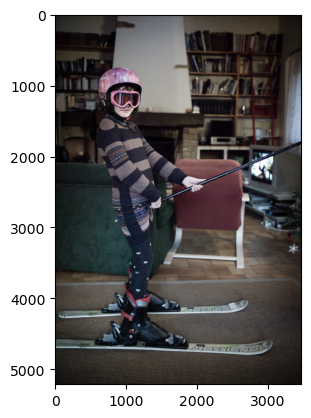

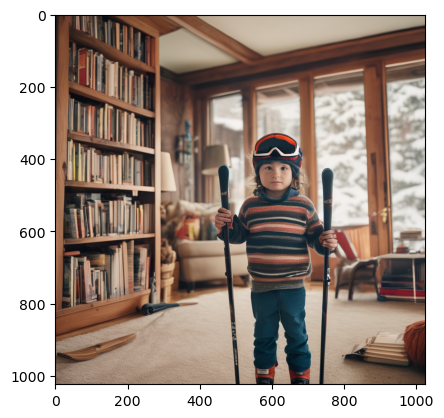

366_pjpg_8333140040_o.jpg
generated/366_pjpg_8333140040_o.jpg
a young child wearing a white dress and a pink hat, holding a camera in front of their face. the child is standing on a tiled floor with a wooden cabinet behind them. there are two shoes visible in the image, one on the left side and the other on the right side. the child appears to be taking a selfie using the camera.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a young girl wearing a white dress and a pink hat, holding a camera. she is standing in front of a wooden cabinet with multiple pairs of shoes on it. the room has a checkered pattern on the floor, and there are framed pictures or photos on the wall behind the cabinet.


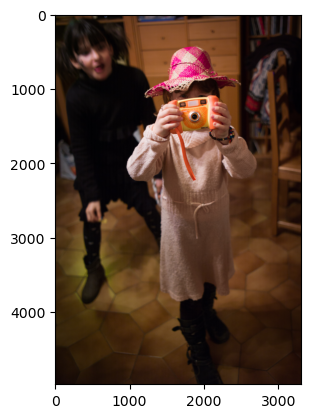

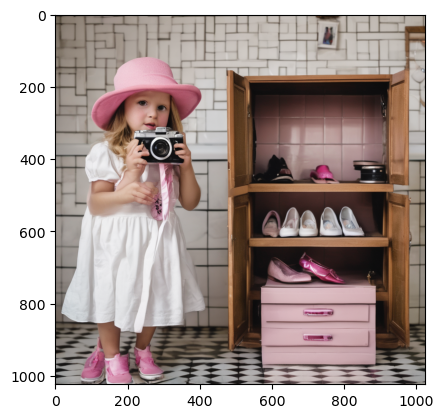

363_pjpg_8318852185_o.jpg
generated/363_pjpg_8318852185_o.jpg
an open window with a latch on it, positioned in front of a brick wall. the window appears to be made of metal or glass, and there are no other objects visible outside the window.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

an old brick wall with a window, a camera, two screwdrivers, and three bolts. the camera is positioned to the left of the screwdrivers, and there are no other objects on the windowsill. the boltdrivers are located near the bottom right corner of the image, closer to the window than the camera's handle. the setting appears to be outdoors, possibly in a residential or older part of a building.


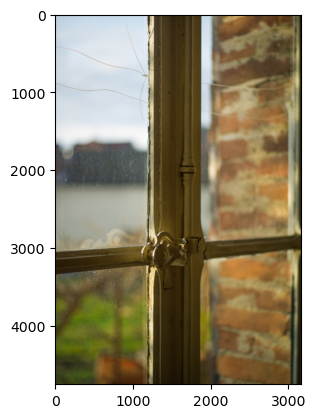

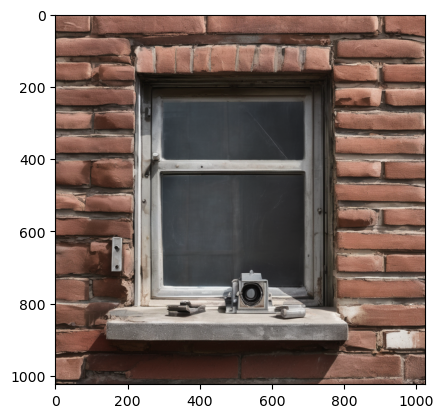

361_pjpg_8310887011_o.jpg
generated/361_pjpg_8310887011_o.jpg
multiple boats of varying sizes and colors anchored in a harbor or marina. the largest boat is located towards the left side of the image, while the smaller boat is further back on the right side. there are several masts scattered throughout the harbor, with some closer to the foreground and others farther away. additionally, there's a buoy near the center - bottom part of the image.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

multiple boats of various sizes and designs, including masts, docked in a harbor or marina. the largest boat is located towards the left side of the image, while the smaller boat is on the right side. there are at least three people present in the image, with one closer to the foreground and another further away. the overall mood of the image is calm and tranquil, evoking a sense of depth and connection with nature.


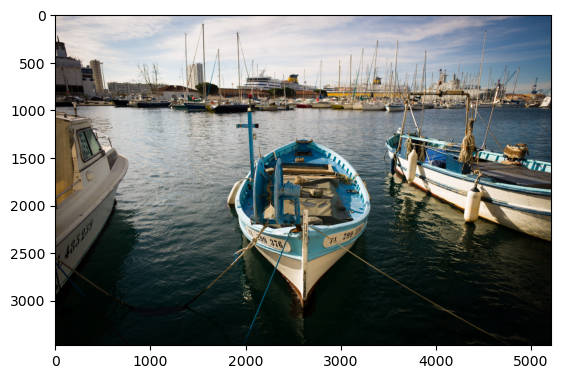

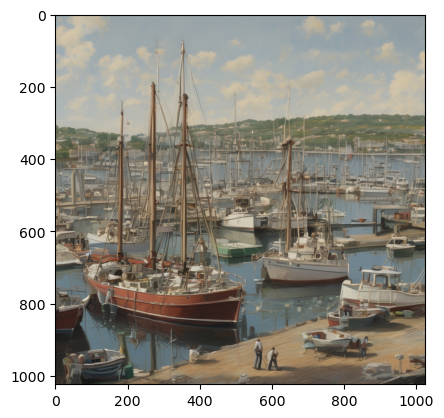

365_pjpg_8325735077_o.jpg
generated/365_pjpg_8325735077_o.jpg
an indoor setting, possibly a living room or lounge area, with three people present. one person is playing a game of table soccer, while the other two are watching. there is a christmas tree in the background, and the floor has a checkered pattern. the scene appears to be set up for a casual gathering or party, as evidenced by the festive atmosphere.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a group of five people gathered around a wooden table in a living room setting. the room has a christmas tree decorated with ornaments, and there is a television set on the left side of the image. the atmosphere appears to be relaxed and festive, possibly during the holiday season.


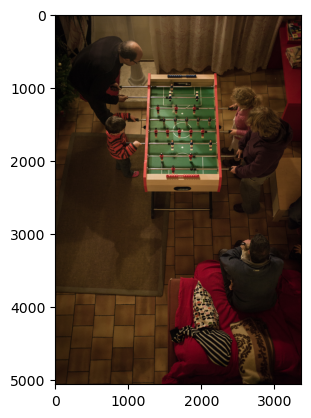

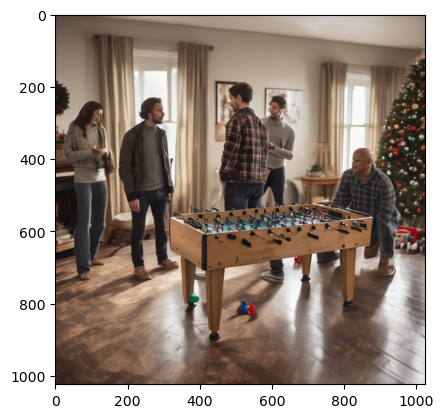

360_pjpg_8308426164_o.jpg
generated/360_pjpg_8308426164_o.jpg
a nighttime scene of a cityscape with a prominent building in the background, illuminated by artificial lights. there are multiple trees and shrubs surrounding the area, creating a calm and serene ambiance. the lighting suggests it might be either early morning or late afternoon. the image does not show any people or animals, and the time of day is difficult to determine from the image alone.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a nighttime cityscape with tall buildings in the background, illuminated by streetlights. there is a tree on the left side of the image, and no vehicles or people are present. the overall mood of the image is serene and tranquil, evoking feelings of solitude and reflection.


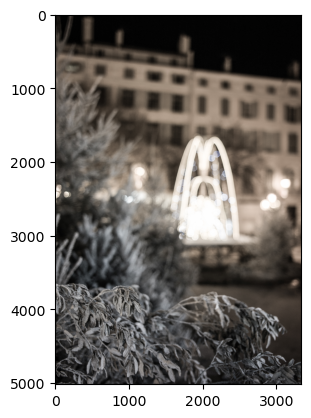

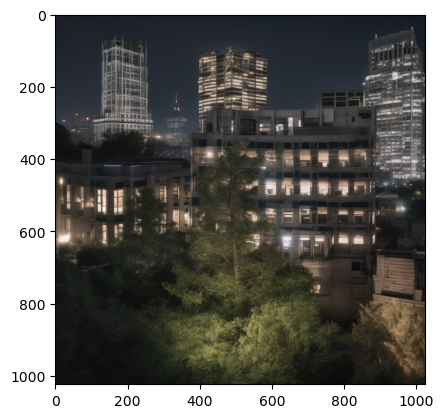

356_pjpg_8293845599_o.jpg
generated/356_pjpg_8293845599_o.jpg
a bathroom setting with a bathtub, two headphones, and a piece of paper or notebook. the bathtub is located on the left side of the image, while the earphones are positioned to the right of the bathtub. there are no other objects in the image apart from the bathtub and the handwritten notes.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a bathroom setting with a bathtub, two speakers, a book, and a flower arrangement. the books are placed on the bathtub's surface, while the speaker is positioned to the left of the book. there are no plants or animals visible in the image.


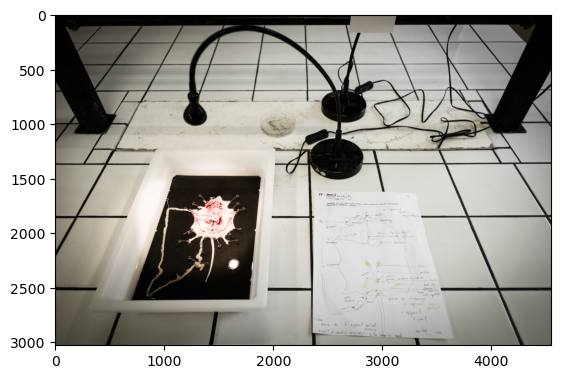

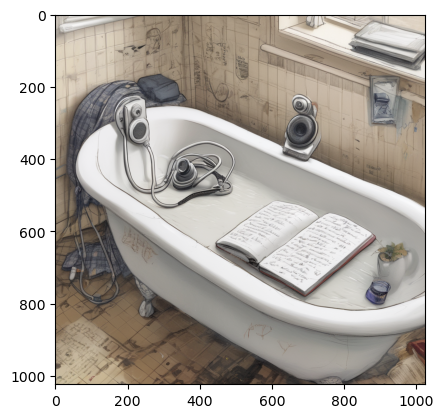

357_pjpg_8297010017_o.jpg
generated/357_pjpg_8297010017_o.jpg
an indoor setting, possibly a shopping mall or a pet store, with multiple people present. there are two dogs in the image, one wearing a yellow hat and the other wearing a black jacket. the dog is inside a white cage - like structure, which appears to be part of a cart or crate. the atmosphere is relaxed and casual, with some individuals interacting with each other.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

two individuals wearing yellow jackets, with one person in the foreground interacting with a white dog inside a cage. the setting appears to be an indoor environment, possibly a pet store or a pet store. there are multiple cages filled with various animals, including dogs and cats. the atmosphere is calm and organized, with people engaged in conversation and waiting for their turn. the lighting suggests it might be daytime, but the exact time of day cannot be determined from the image alone.


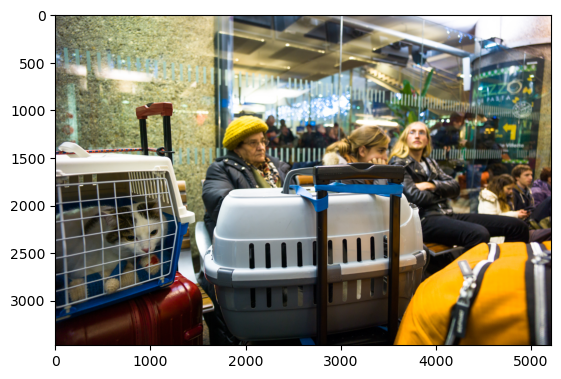

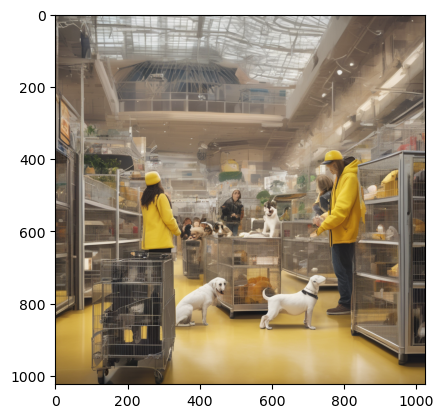

358_pjpg_8301295919_o.jpg
generated/358_pjpg_8301295919_o.jpg
a young child sitting on the floor in front of a television set displaying a scene with various characters. there are two remote controls visible in the image, one near the child and the other closer to the television. the room has a cozy ambiance with wooden flooring and shelves filled with books, suggesting a home setting.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a young boy sitting on the floor in front of a television set, with two toys nearby. the room has a cozy ambiance with wooden flooring and various objects such as bookshelves, toys, and other miscellaneous items. there is a teddy bear positioned to the left of the television set, closer to the child's face. the scene appears to be from a childhood story or animated movie, based on the children's playtime and the overall mood of the image.


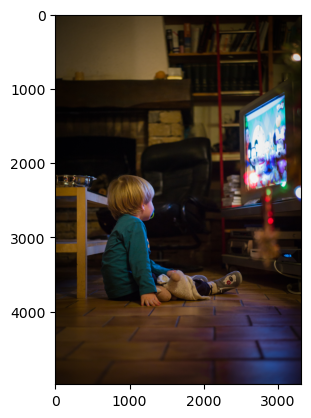

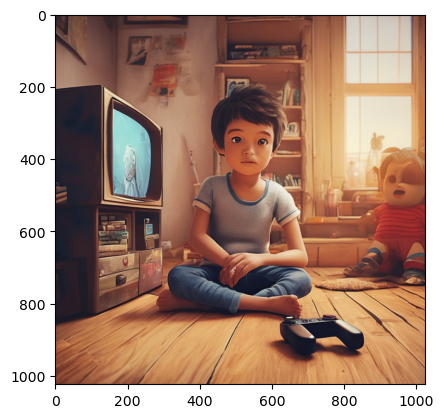

362_pjpg_8314663859_o.jpg
generated/362_pjpg_8314663859_o.jpg
a collage of nine photographs with various scenes, including a woman in a dress and a man in a suit, a dog wearing a helmet, a cat sitting on a chair, a person standing near a building, and an outdoor setting. the background consists of a large red heart - shaped structure that looks like a bridge or archway. the overall mood of the image is nostalgic and whimsical, evoking a sense of nostalgia and connection with nature.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a vibrant urban scene with two individuals dressed in historical attire, one wearing a red hat and the other wearing a blue outfit. they are surrounded by various animals, including dogs, cats, and birds. the background features a grand building with a dome - like structure, possibly a church or cathedral, and a bridge over a body of water. there are several people present, some interacting with each other, while others are standing on either side of the river. the setting suggests a special event or celebration, such as a valentine's day or an anniversary.


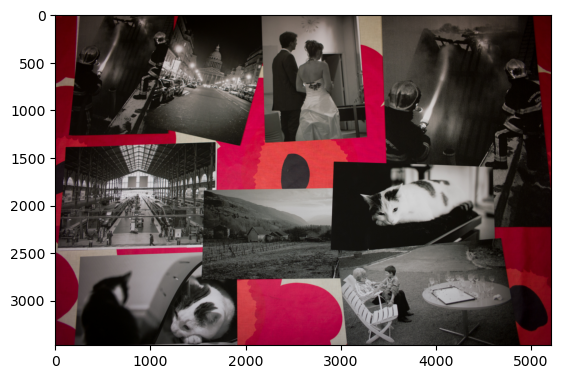

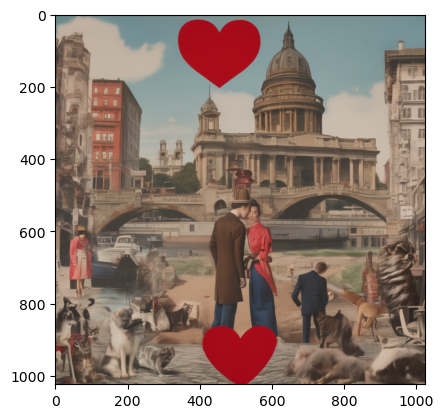

In [33]:

for image_name in glob.glob("*.jpg")+glob.glob("*.jpeg") :
    print(image_name)
    print("generated/"+os.path.basename(image_name))
    plt.imshow(plt.imread(image_name))
    plt.figure()
    images = generate(image_name)
    plt.imshow(np.array(images))
    plt.imsave("generated/"+os.path.basename(image_name),np.array(images))
    plt.show()

Default_an_old_worn_out_room_with_a_window_on_the_left_side_t_0.jpg
generated/Default_an_old_worn_out_room_with_a_window_on_the_left_side_t_0.jpg
an old room with a window, a radiator, and debris on the floor. there are two windows in the room, one on the left side and the other on the right side. the room appears to be undergoing renovation or repair, as evidenced by the damaged walls and exposed ceiling tiles. the room is likely used for various purposes, such as cleaning up, maintenance, or remodeling activities.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a room with two windows, one on the left side and the other on the right side. there is a radiator in the center of the room, located to the right of the window. the room appears to be undergoing renovation or repair, with peeling paint and debris scattered around it.


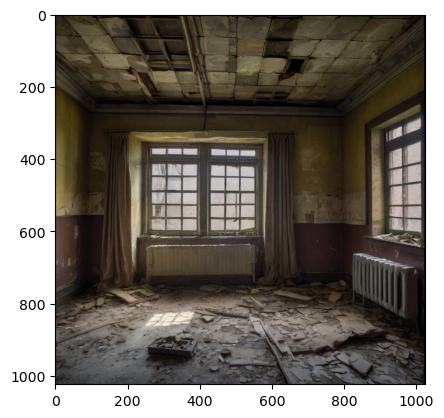

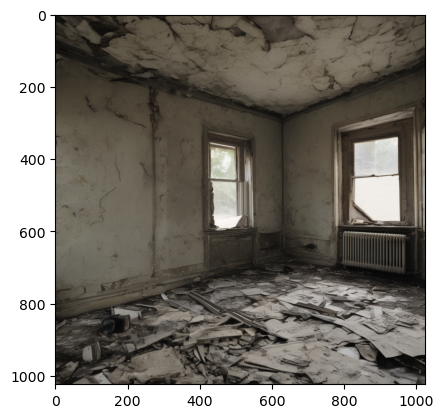

Default_a_well_maintained_and_well_maintained_outdoor_space_2.jpg
generated/Default_a_well_maintained_and_well_maintained_outdoor_space_2.jpg
a green trash can is located to the left of a red brick building, which appears to be part of an urban or semi - industrial complex. the ground is wet with puddles of water, indicating recent rainfall. there are trees and buildings in the background, but no people are present. the area seems to be well - maintained, possibly for maintenance or cleaning purposes. the time of day is not explicitly clear, but it could be either early morning or late afternoon based on the lighting and shadows.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a green trash can is placed on the ground in front of a brick building with multiple windows. the environment appears to be wet, possibly due to recent rainfall or rain. there are no other people or animals visible in the image.


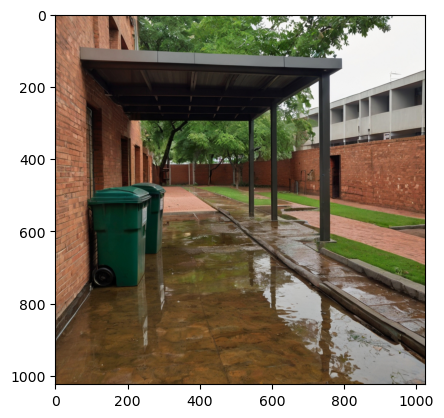

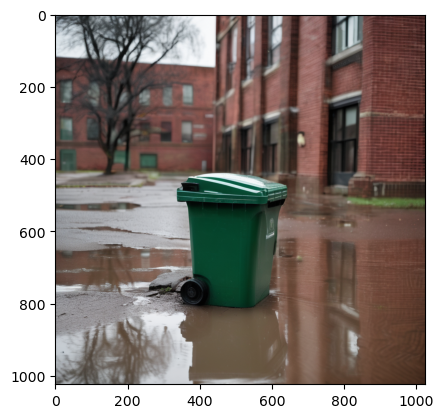

Default_an_interior_view_of_a_gothic_style_church_or_cathedra_1.jpg
generated/Default_an_interior_view_of_a_gothic_style_church_or_cathedra_1.jpg
a gothic - style church interior with large stained glass windows, tall columns, and a central altar. the main focus is on the altar with multiple lit candles placed in front of it. the overall ambiance suggests a calm and serene atmosphere, possibly during a special occasion or ceremony. the lighting appears to be natural, suggesting it might be either early morning or late afternoon. there are no animals or people visible in the image.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

the interior of a gothic - style church with multiple pews and flower arrangements. the main altar is surrounded by tall, arched windows with stained glass panels. the lighting suggests it might be either early morning or late afternoon. there are no people visible in the image, and the overall ambiance is calm and serene. the church's architectural style is reminiscent of gothic revival architecture, possibly from the 19th or early 20th century.


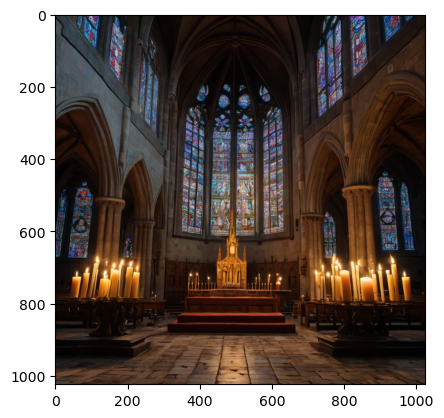

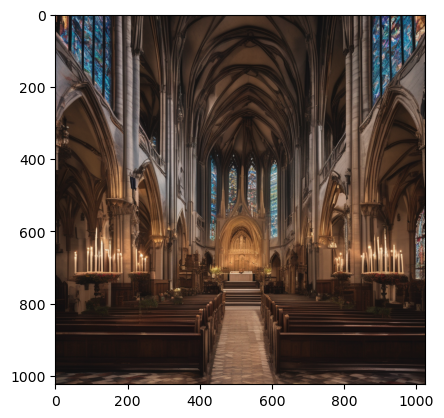

Default_a_nighttime_scene_of_a_cityscape_with_a_vibrant_skylin_1.jpg
generated/Default_a_nighttime_scene_of_a_cityscape_with_a_vibrant_skylin_1.jpg
a nighttime scene of a cityscape with tall skyscrapers illuminated in pink and blue lights, reflecting on the water's surface. the boat is located towards the right side of the image, closer to the foreground. there are no other boats or ships visible in the image. the lighting suggests it might be either early morning or late afternoon. the time of day is difficult to determine from the image alone, but it appears to be taken during the evening or night.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a vibrant cityscape during dusk or dawn, featuring tall buildings reflecting in the water. there are multiple boats moored near the shore, with some closer to the foreground and others further away. the sky appears to be filled with pinkish hues, suggesting it might be either early morning or late afternoon. the overall mood of the image is serene and tranquil, evoking a sense of calmness and reflection.


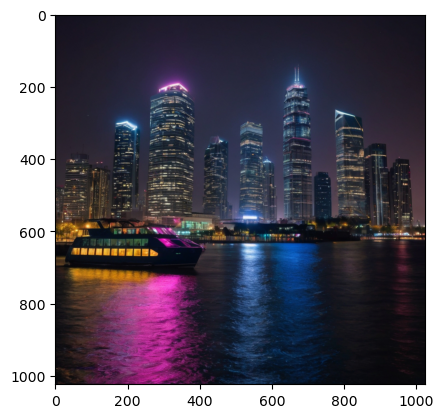

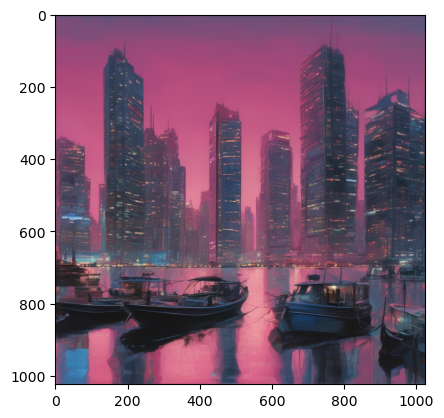

Default_a_well_maintained_and_well_maintained_outdoor_space_1.jpg
generated/Default_a_well_maintained_and_well_maintained_outdoor_space_1.jpg
a green trash can on the left side of the image, surrounded by greenery. there is a brick building with multiple windows in the background, and a grassy area to the right of the trash can. the ground appears wet, suggesting recent rain or recent rainfall. the surroundings include a well - maintained lawn with patches of green grass, a water puddle, and a tree providing shade. no animals or people are visible in the image.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a green trash can on the grass near a brick building with multiple windows. there is a wet puddle in the ground, indicating recent rainfall. the trash can is located to the left of the trash can, and there are no people or animals visible in the image.


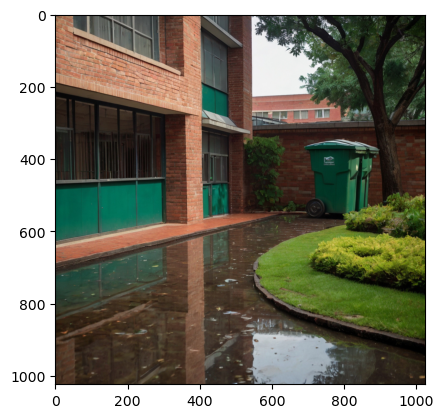

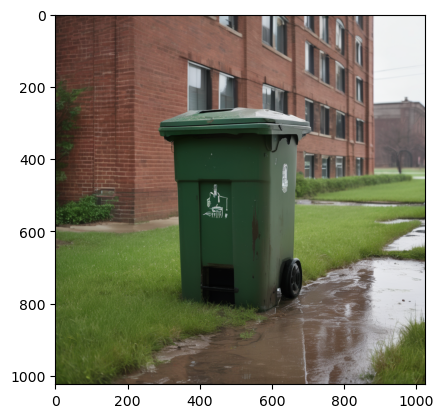

Default_a_nighttime_scene_of_a_cityscape_with_a_vibrant_skylin_3.jpg
generated/Default_a_nighttime_scene_of_a_cityscape_with_a_vibrant_skylin_3.jpg
a cityscape with tall buildings, including one of the tallest skyscrapers in the background, illuminated at dusk or dawn. there are multiple boats floating on the water, with some closer to the foreground and others further away. the sky is filled with pinkish hues, suggesting it might be either dawn or dusk.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a serene cityscape with tall buildings reflecting in the water. the sky is filled with pinkish hues, suggesting it might be either dawn or dusk. there are multiple boats moored near the shore, and no people are visible in the image. the time of day appears to be either early morning or late afternoon, based on the lighting and shadows.


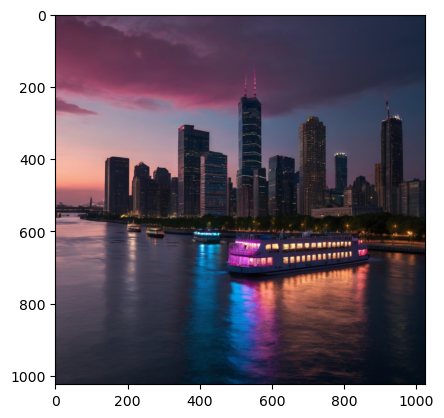

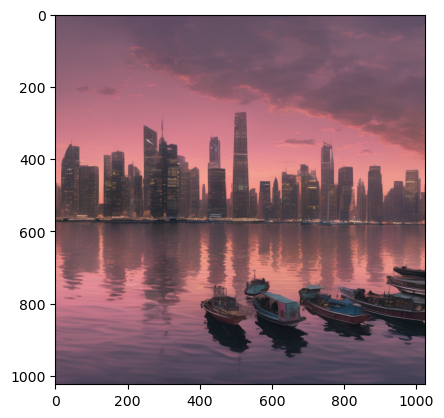

Default_an_interior_view_of_a_gothic_style_church_or_cathedra_3.jpg
generated/Default_an_interior_view_of_a_gothic_style_church_or_cathedra_3.jpg
multiple lit candles are placed on a circular table in front of two large stained glass windows. the setting appears to be a church or chapel, with stone flooring and intricate architectural details. the lighting suggests it might be either early morning or late afternoon. there are no people visible in the image, and the overall ambiance is calm and serene.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

an interior view of a gothic - style church or chapel with stained glass windows, wooden pews, and multiple lit candles arranged in rows. the altar is surrounded by intricately designed pews, creating a serene ambiance. the lighting suggests it might be either early morning or late afternoon, as indicated by the warm glow from the stained glass windows. there are no animals or people visible in the image. the overall ambiance appears to be peaceful and celebratory, evoking a sense of tranquility and reflection.


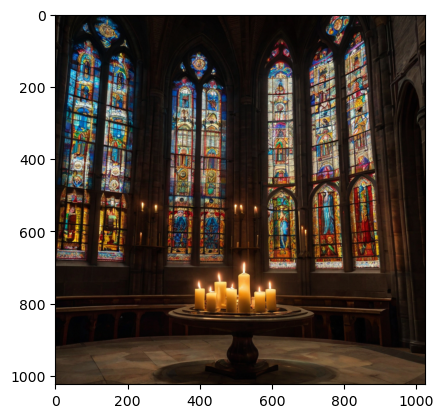

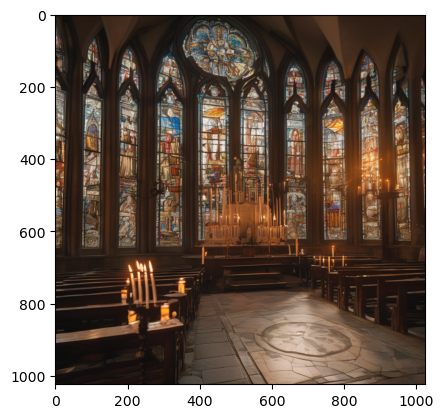

a-stunning-4k-photo-of-a-staircase-illuminated-by--YlgLkbY_SCa55sKjwtwy9A-4mSnum9BSbOLIbzbpPbMZQ.jpeg
generated/a-stunning-4k-photo-of-a-staircase-illuminated-by--YlgLkbY_SCa55sKjwtwy9A-4mSnum9BSbOLIbzbpPbMZQ.jpeg
a group of people walking on a sidewalk near a do not enter sign, with the sun shining brightly in the background. there is a blue staircase leading up to the entrance of a building or structure, and the sky appears to be either early morning or late afternoon. the lighting suggests it might be either early morning or late afternoon. the image does not provide enough context to determine the exact time of day, but it could be either early morning or late afternoon.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a group of people walking on a sidewalk in front of a building with a sign that reads doa not ett. there are several buildings in the background, including one with a light blue facade and another with white windows. the sky appears to be clear, suggesting a sunny day. the time of day is either early morning or late afternoon, as indicated by the shadows cast on the ground. no vehicles or pedestrians are visible in the image.


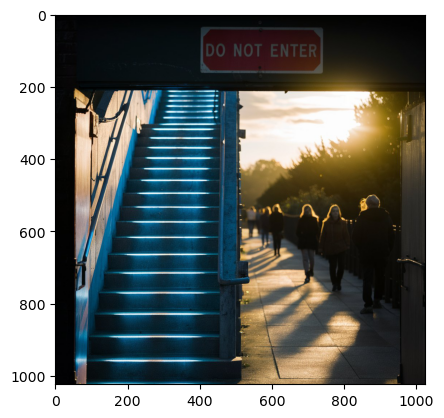

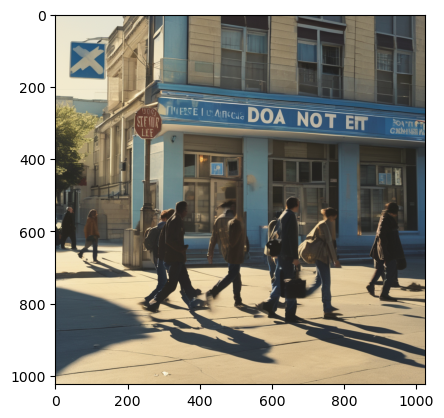

a-vibrant-high-resolution-photo-showcasing-a-beaut-XjaNlvPnRQO1HES6pWQnMg-CxsClOWiQCKTzR-wE6dkEg.jpeg
generated/a-vibrant-high-resolution-photo-showcasing-a-beaut-XjaNlvPnRQO1HES6pWQnMg-CxsClOWiQCKTzR-wE6dkEg.jpeg
a table with a blue plate featuring a bulldog wearing a pirate hat on its head, surrounded by various objects such as wine glasses, napkins, and other decorative items. there is also a flower arrangement in the top right corner of the image.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a table setting with a bulldog wearing a pirate hat, surrounded by various objects such as wine glasses, plates, and cutlery. there is also a flower arrangement in the top right corner of the image. the dog appears to be sitting on the plate, looking directly at the camera. the overall mood or atmosphere of the image is whimsical and whimsical, evoking a nostalgic and whimsical ambiance.


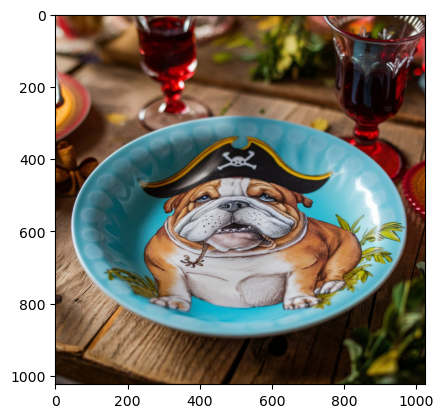

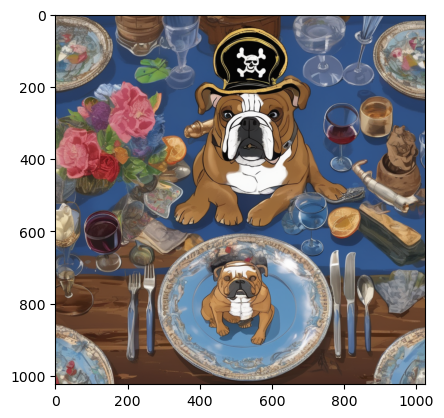

a-stunning-4k-high-resolution-photo-of-a-beautiful-5e2HxeHqQ4KEETF0lJiK0w-CxsClOWiQCKTzR-wE6dkEg.jpeg
generated/a-stunning-4k-high-resolution-photo-of-a-beautiful-5e2HxeHqQ4KEETF0lJiK0w-CxsClOWiQCKTzR-wE6dkEg.jpeg
a bulldog wearing a pirate hat with a skull and crossbones on its forehead, placed on a plate. there are two wine glasses in the image, one to the left and the other to the right of the dog. the setting appears to be a casual dining environment, possibly at a home or a restaurant.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

a bulldog wearing a pirate hat with a skull and crossbones on its forehead, sitting at a dining table. there is a plate with lemons in front of it, along with a glass filled with a drink. the setting appears to be an indoor environment, possibly a dining area or a restaurant, with curtains visible in the background.


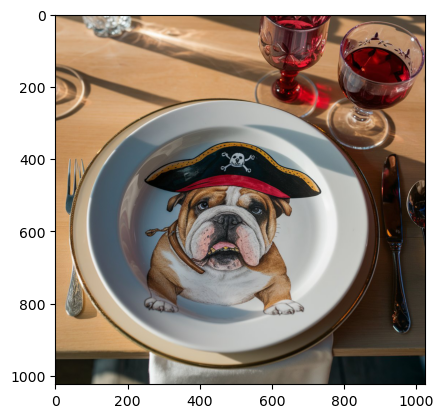

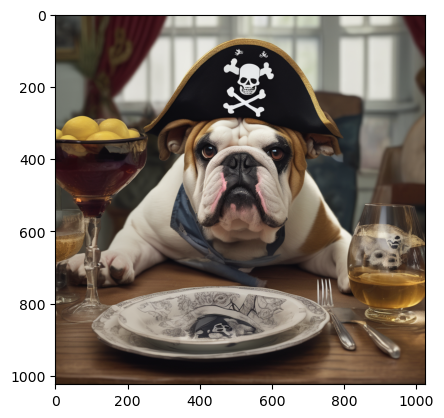

In [ ]:

for image_name in glob.glob("*.jpg")+glob.glob("*.jpeg") :
    print(image_name)
    print("generated/"+os.path.basename(image_name))
    plt.imshow(plt.imread(image_name))
    plt.figure()
    images = generate(image_name)
    plt.imshow(np.array(images))
    plt.imsave("generated/"+os.path.basename(image_name),np.array(images))
    plt.show()

Default_an_old_worn_out_room_with_a_window_on_the_left_side_t_0.jpg


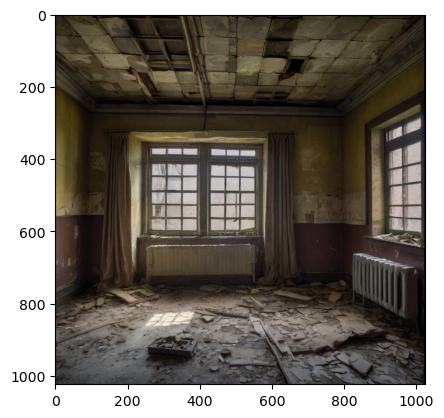

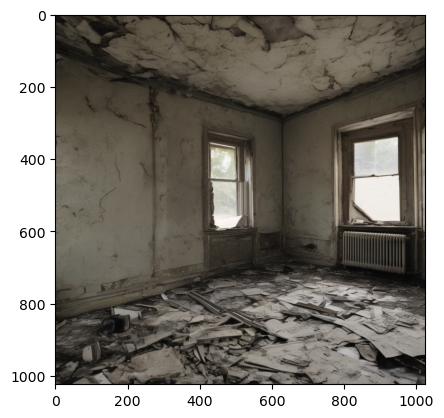

tensor([[0.7790]])
Default_a_well_maintained_and_well_maintained_outdoor_space_2.jpg


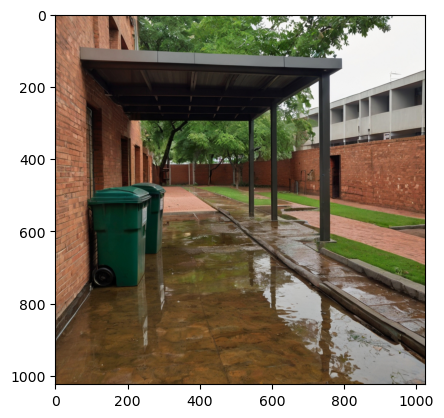

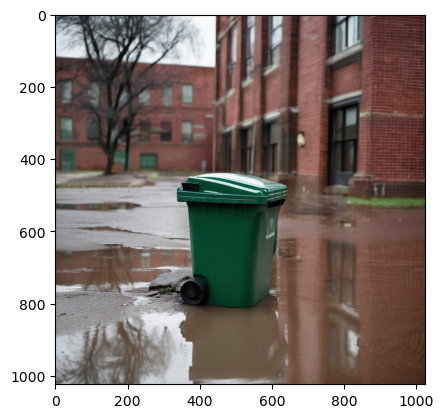

tensor([[0.5524]])
Default_an_interior_view_of_a_gothic_style_church_or_cathedra_1.jpg


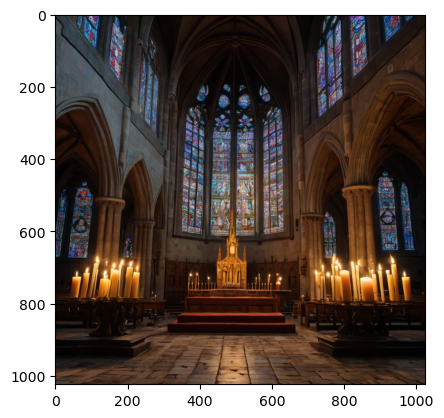

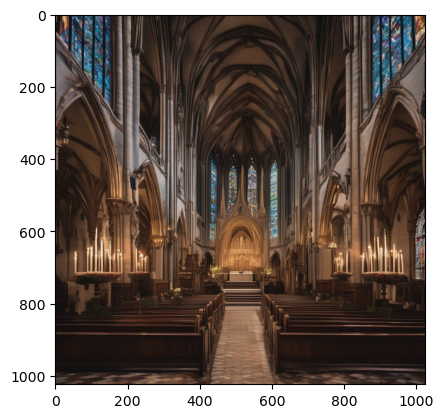

tensor([[0.8114]])
Default_a_nighttime_scene_of_a_cityscape_with_a_vibrant_skylin_1.jpg


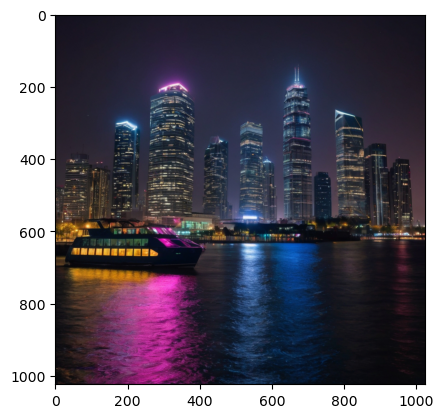

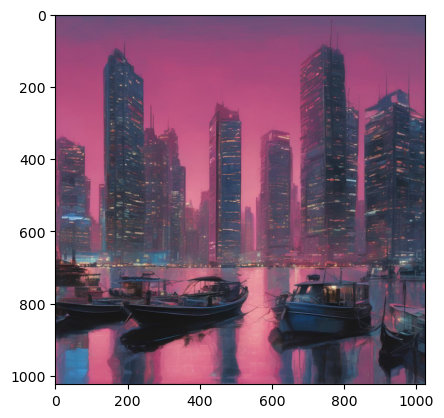

tensor([[0.6654]])
Default_a_well_maintained_and_well_maintained_outdoor_space_1.jpg


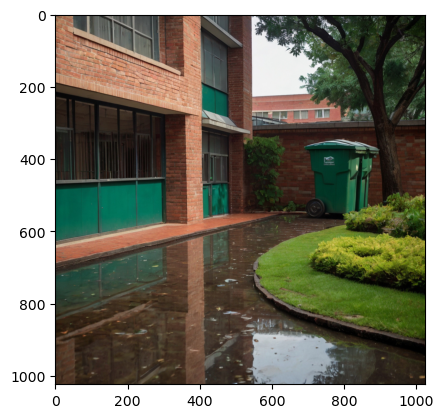

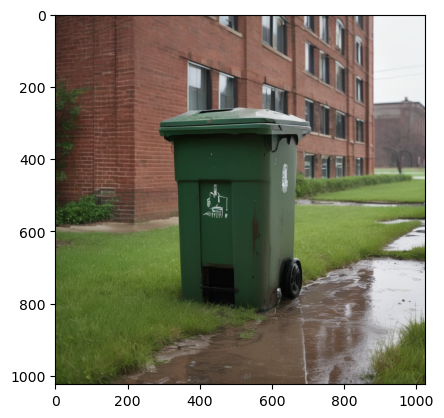

tensor([[0.6665]])
Default_a_nighttime_scene_of_a_cityscape_with_a_vibrant_skylin_3.jpg


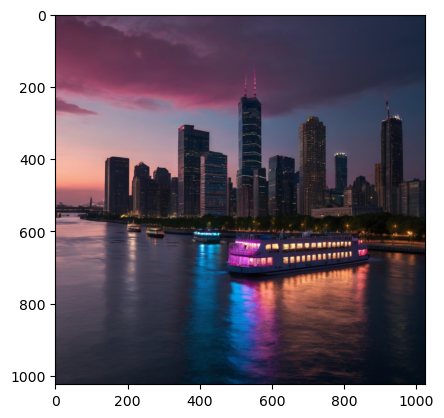

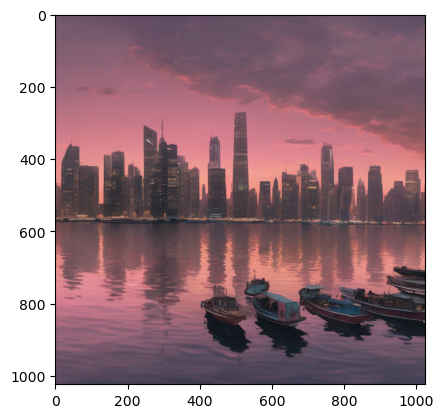

tensor([[0.6773]])
Default_an_interior_view_of_a_gothic_style_church_or_cathedra_3.jpg


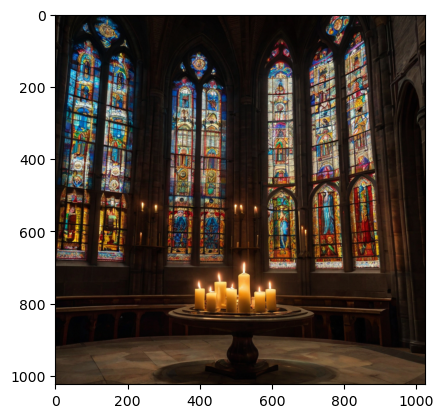

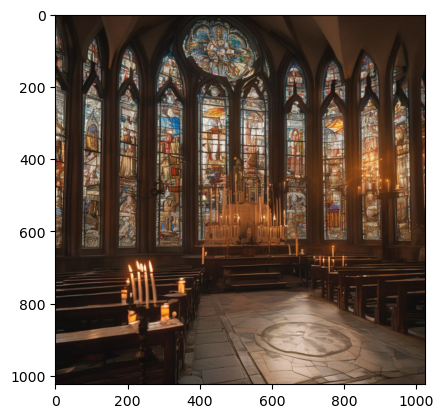

tensor([[0.8333]])
a-stunning-4k-photo-of-a-staircase-illuminated-by--YlgLkbY_SCa55sKjwtwy9A-4mSnum9BSbOLIbzbpPbMZQ.jpeg


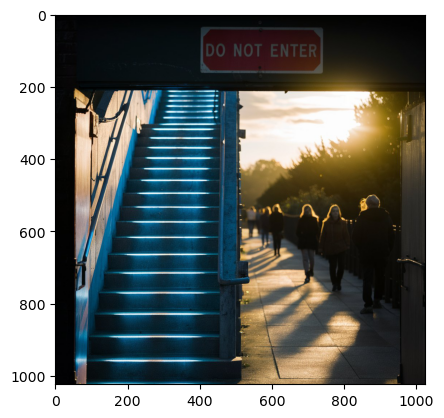

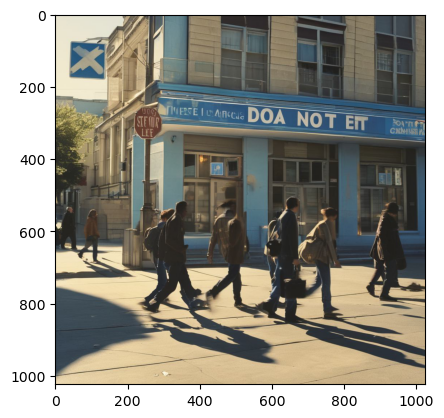

tensor([[0.4747]])
a-vibrant-high-resolution-photo-showcasing-a-beaut-XjaNlvPnRQO1HES6pWQnMg-CxsClOWiQCKTzR-wE6dkEg.jpeg


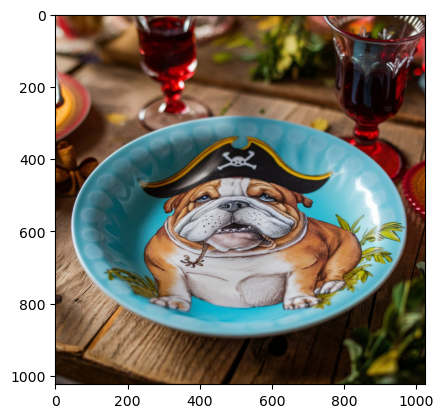

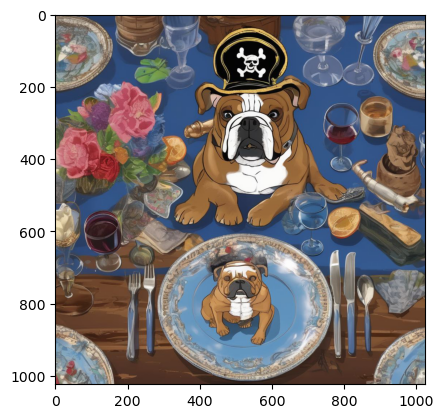

tensor([[0.6875]])
a-stunning-4k-high-resolution-photo-of-a-beautiful-5e2HxeHqQ4KEETF0lJiK0w-CxsClOWiQCKTzR-wE6dkEg.jpeg


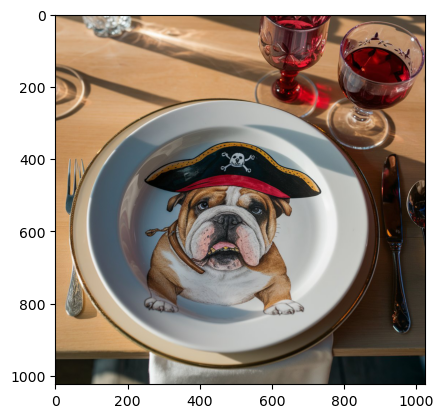

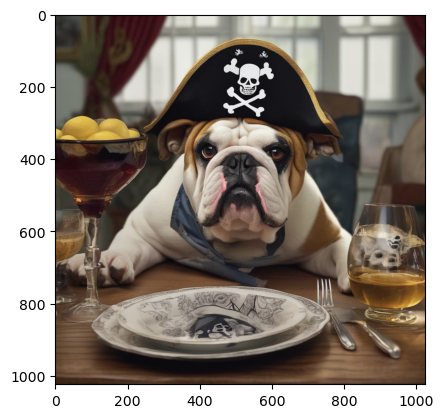

tensor([[0.7604]])


In [32]:
import open_clip

model, preprocess = open_clip.create_model_from_pretrained('hf-hub:laion/CLIP-ViT-L-14-DataComp.XL-s13B-b90K',cache_dir="/data4/bas")
tokenizer = open_clip.get_tokenizer('hf-hub:laion/CLIP-ViT-L-14-DataComp.XL-s13B-b90K')


import torch
from PIL import Image

for image_name in glob.glob("*.jpg")+glob.glob("*.jpeg") :
    print(image_name)
    image1 = Image.open(image_name)
    plt.imshow(np.array(image1.convert('RGB')))
    plt.figure()
    image1 = preprocess(image1).unsqueeze(0)

    image2 = Image.open("generated/"+image_name)
    plt.imshow(np.array(image2.convert('RGB')))
    plt.show()
    image2 = preprocess(image2).unsqueeze(0)
    #text = tokenizer(["a diagram", "a dog", "a cat"])
    

    with torch.no_grad(), torch.cuda.amp.autocast():
        image_features1 = model.encode_image(image1)
        image_features1 /= image_features1.norm(dim=-1, keepdim=True)
        #print(image_features1)

        image_features2 = model.encode_image(image2)
        image_features2 /= image_features2.norm(dim=-1, keepdim=True)
        #print(image_features2)

        dp = image_features1 @ image_features2.T
        print(dp)
        # text_probs = (100.0 * image_features @ text_features.T).softmax(dim=-1)

    # print("Label probs:", text_probs) 

364_pjpg_8323355228_o.jpg


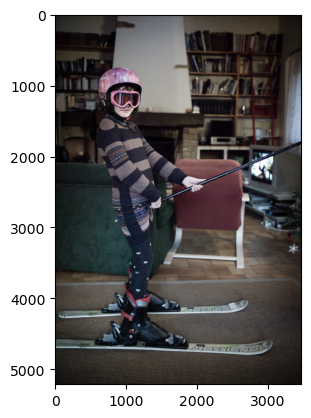

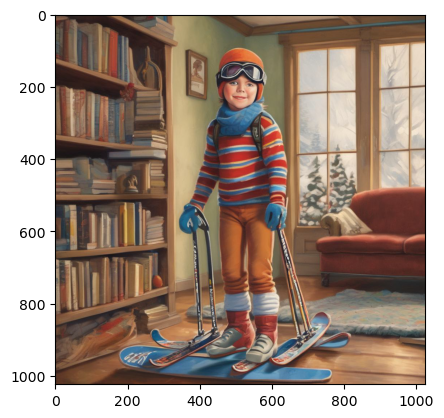

tensor([[0.5624]])
366_pjpg_8333140040_o.jpg


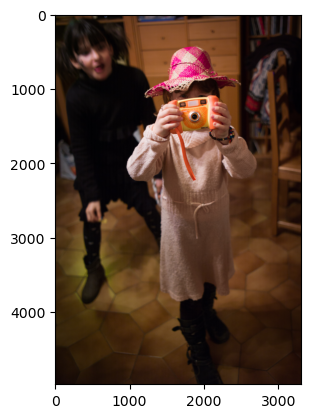

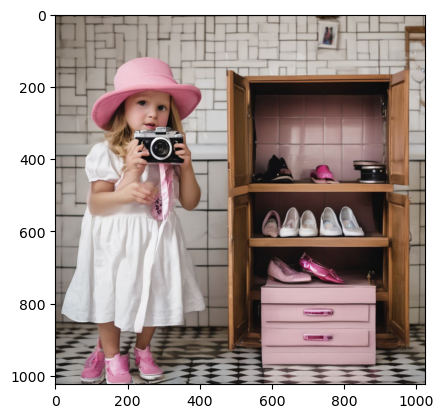

tensor([[0.5068]])
363_pjpg_8318852185_o.jpg


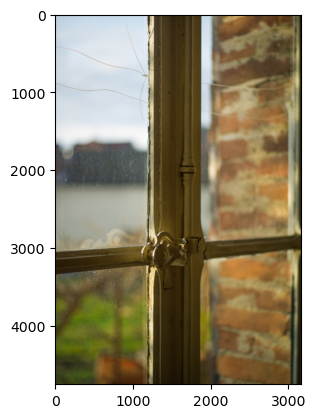

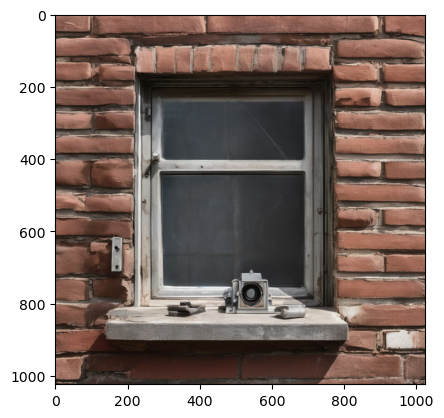

tensor([[0.6182]])
361_pjpg_8310887011_o.jpg


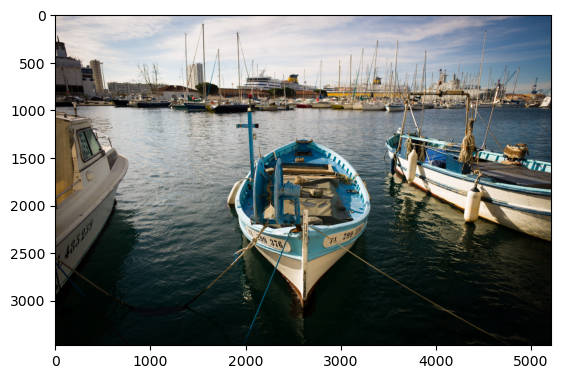

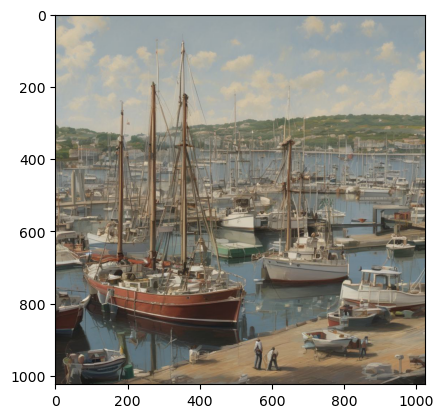

tensor([[0.5306]])
365_pjpg_8325735077_o.jpg


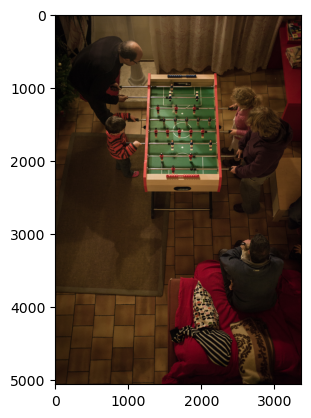

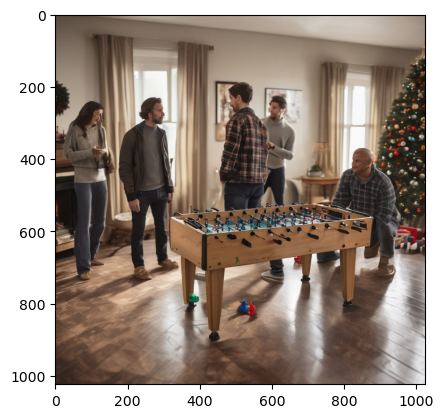

tensor([[0.6086]])
360_pjpg_8308426164_o.jpg


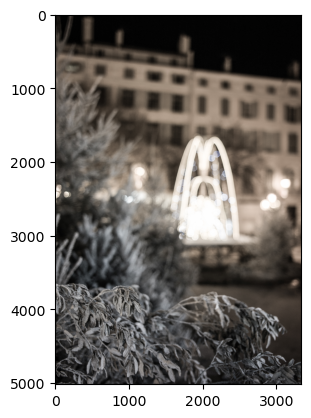

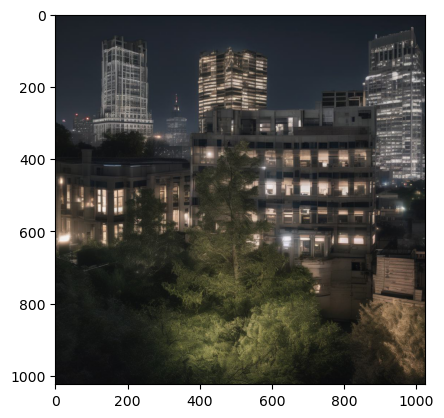

tensor([[0.4173]])
356_pjpg_8293845599_o.jpg


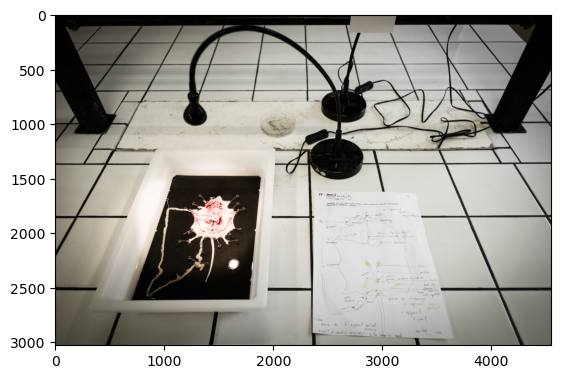

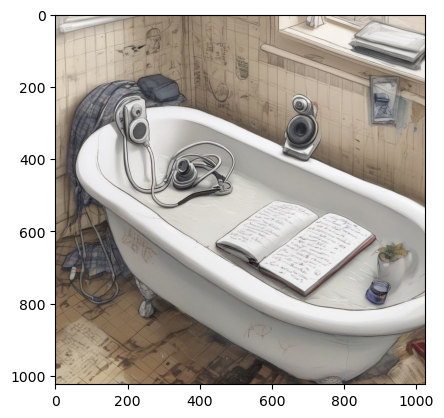

tensor([[0.4364]])
357_pjpg_8297010017_o.jpg


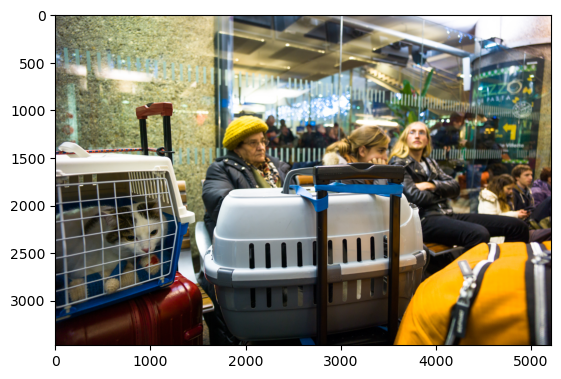

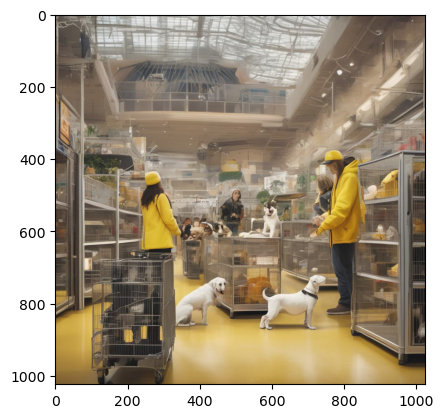

tensor([[0.5473]])
358_pjpg_8301295919_o.jpg


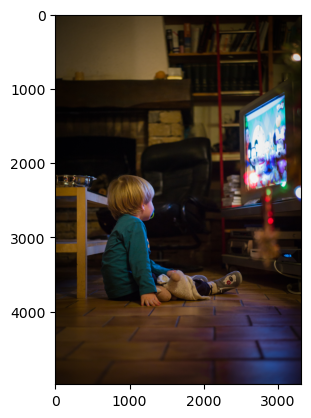

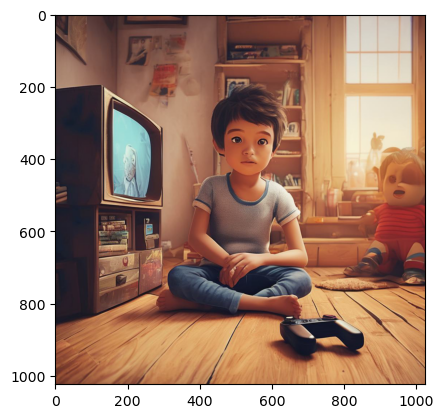

tensor([[0.5573]])
362_pjpg_8314663859_o.jpg


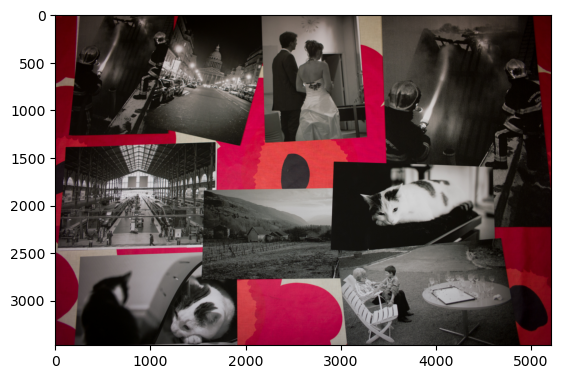

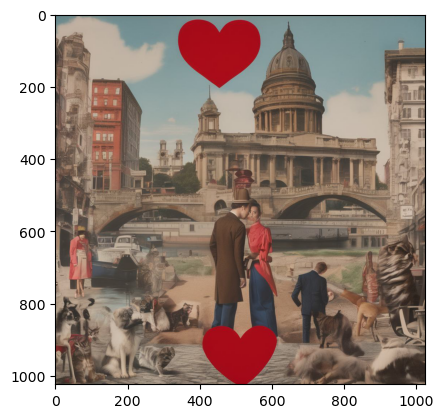

tensor([[0.5366]])


In [36]:
import open_clip

model, preprocess = open_clip.create_model_from_pretrained('hf-hub:laion/CLIP-ViT-L-14-DataComp.XL-s13B-b90K',cache_dir="/data4/bas")
tokenizer = open_clip.get_tokenizer('hf-hub:laion/CLIP-ViT-L-14-DataComp.XL-s13B-b90K')


import torch
from PIL import Image

for image_name in glob.glob("*.jpg")+glob.glob("*.jpeg") :
    print(image_name)
    image1 = Image.open(image_name)
    plt.imshow(np.array(image1.convert('RGB')))
    plt.figure()
    image1 = preprocess(image1).unsqueeze(0)

    image2 = Image.open("generated/"+image_name)
    plt.imshow(np.array(image2.convert('RGB')))
    plt.show()
    image2 = preprocess(image2).unsqueeze(0)
    #text = tokenizer(["a diagram", "a dog", "a cat"])
    

    with torch.no_grad(), torch.cuda.amp.autocast():
        image_features1 = model.encode_image(image1)
        image_features1 /= image_features1.norm(dim=-1, keepdim=True)
        #print(image_features1)

        image_features2 = model.encode_image(image2)
        image_features2 /= image_features2.norm(dim=-1, keepdim=True)
        #print(image_features2)

        dp = image_features1 @ image_features2.T
        print(dp)
        # text_probs = (100.0 * image_features @ text_features.T).softmax(dim=-1)

    # print("Label probs:", text_probs) 